In [282]:
%matplotlib inline
import cv2 as cv
from matplotlib import pyplot as plt
import numpy as np
from scipy import linalg
from numpy import linalg as LA
import math
import random

# Direct Linear Transform
- Implementation
- We perform DLT based calibration on a given image and estimate the camera parameters.
- We use 20-30 different points on different planes and report the projection, camera, rotation matrices.
- The given image is 'calib-object.jpg'. We need to manually estimate the image coordinates by referring to 'calib-object-legend.jpg' for world measurements

<IPython.core.display.Javascript object>


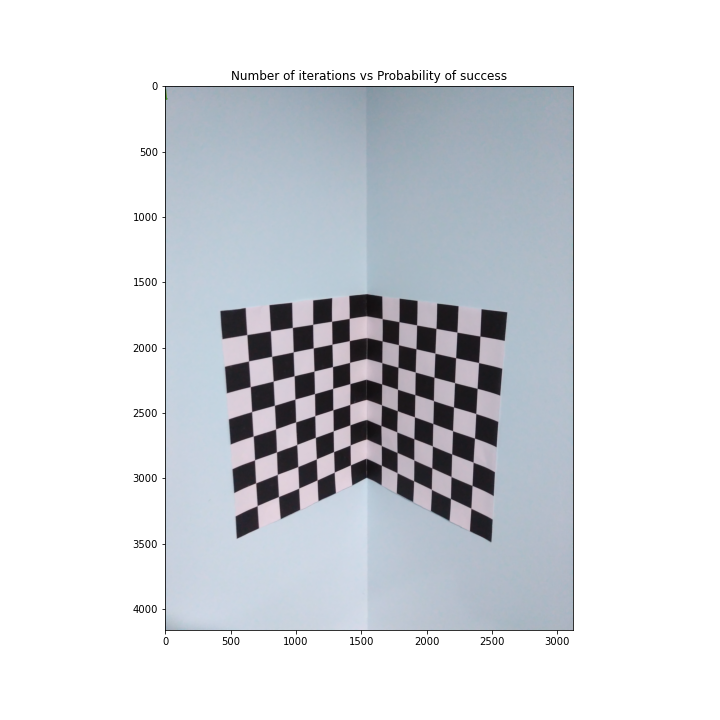

In [284]:
%matplotlib notebook
img1 = cv.imread('C:/Users/91709/Desktop/CV/assignment-1-rez39/calibration-data/calib-object.jpg')
plt.figure(figsize=[10,10])
plt.imshow(img1)
plt.show()

# World Points and Image Points Control Points
- (0,0,0) - (1536, 1588)
- (0,28,0) - (1543,1749)
- (56,0,0) - (1788, 1619)
- (56,28,0) - (1788, 1795)
- (56,84,0) - (1781, 2147)
- (84,84,0) - (1911, 2177)
- (112,56,0) - (2069, 2051)
- (112,84,0) - (2061, 2233)
- (84,56,0) - (1928, 2015)
- (84,112,0) - (1915, 2366)
- (0,28,28) - (1413, 1781)
- (0,28,56) - (1280, 1807)
- (0,56,28) - (1415, 1958)
- (0,56,56) - (1283, 1981)
- (0,56,84) - (1139, 2013)
- (0,56,112) - (990, 2041)
- (0,112,0) - (1541, 2251)
- (0,112,28) - (1420, 2287)
- (0,112,56) - (1292, 2320)
- (0,112,84) - (1149, 2356)
- (0,112,112) - (1005, 2401)
- (28,0,0) - (1651,1611)
Two matrices with world coordinates and image coordinates as world and image

In [285]:
world = [ (0,0,0), (0,28,0), (56,0,0), (56,28,0), (56,84,0), (84,84,0), (112,56,0),
             (112,84,0), (84,56,0), (84,112,0), (0,28,28), (0,28,56), (0,56,28), (0,56,56), 
             (0,56,84), (0,56,112), (0,112,0), (0,112,28), (0,112,56), (0,112,84), (0,112,112), (28,0,0) ]

image = [ (1536, 1588), (1543, 1749), (1788, 1619), (1788, 1795), (1781, 2147), (1911, 2177),
             (2069, 2051), (2061, 2233), (1928, 2015), (1915, 2366), (1413, 1781), (1280, 1807),
             (1415, 1958), (1283, 1981), (1139, 2013), (990, 2041), (1541, 2251), (1420, 2287),
            (1292, 2320), (1149, 2356), (1005, 2401),(1651,1611)]

# DLT matrix (2nx12)
n=22 as number of points selected is 22
Therefore DLT matrix DIMS = 44x12


In [286]:
dlt_mat = []
dlt_mat = np.array(dlt_mat)

for i in range(0,22):
    x = []
    x = np.array(x)
    
    e1 = -1*world[i][0]
    e2 = -1*world[i][1]
    e3 = -1*world[i][2]
    
    x = np.append(x, (e1,e2,e3))
    x = np.append(x, (-1,0,0,0,0))
    
    e9 = image[i][0]*world[i][0] 
    e10 = image[i][0]*world[i][1] 
    e11 = image[i][0]*world[i][2] 
    e12 = image[i][0]
    x = np.append(x, (e9,e10,e11,e12))
    row1 = x
    y = []
    y = np.array(y)
    y = np.append(y, (0,0,0,0))
    
    e5 = -1*world[i][0]
    e6 = -1*world[i][1]
    e7 = -1*world[i][2]
    y = np.append(y, (e5,e6,e7,-1))
    
    e9 = image[i][1]*world[i][0] 
    e10 = image[i][1]*world[i][1] 
    e11 = image[i][1]*world[i][2] 
    e12 = image[i][1]
    y = np.append(y, (e9,e10,e11,e12))
    row2 = y
    dlt_mat = np.append(dlt_mat, row1)
    dlt_mat = np.append(dlt_mat, row2)
dlt_mat = dlt_mat.reshape(44, 12)
print(dlt_mat.shape)

(44, 12)


# SVD solving of linear equations
- We do this by applying singular value decomposition (SVD) to dlt_mat.
- M = U S V.T
- The solution is the last column of V

In [287]:
U, S, V = np.linalg.svd(dlt_mat)
P=V[-1,:]
P = np.array(P)
P = np.reshape(P,(3,4))
P=P/P[2,3]
print('The Projection matrix is \n',P)


The Projection matrix is 
 [[ 2.26247047e+00  5.72326643e-01 -5.95409809e+00  1.53819757e+03]
 [-1.41891164e+00  6.65374048e+00 -8.88776113e-01  1.58879011e+03]
 [-1.22334300e-03  3.46227943e-04 -9.66769882e-04  1.00000000e+00]]


## Lets check if the projection matrix is correct or not by considering a single world point first
- Projection matrix is P
- One of our world points, in homogeneous coordinates is (56,28,0,1) - (4x1).
- Let's multiply P with the world point to get the image coordinates.

In [288]:
point = np.array([56,28,0,1])
xy = np.dot(P, point)
xy = xy/xy[2]
with np.printoptions(suppress=True): print('Estimated Image points',xy[0:2])
print('Original Image Points',image[3])

Estimated Image points [1785.95831689 1801.5925347 ]
Original Image Points (1788, 1795)


- Now we loop through all our 3D points and using the projection matrix, project it back to 2D.
- Then, we compare it with the actual 2D coordinates using np.linalg.norm
- If the error is minimal (below a threshold value), we accept that the point has been projected correctly

In [289]:
# Projection error
ones = np.ones((22,1))
image = np.array(image)
image_new = np.hstack((image, ones))

world = np.array(world)
world_new = np.hstack((world, ones))
c=1
error=[]
for i in range(0,22):
    expected = np.dot(P, world_new[i])
    expected = expected/expected[2]
    actual = image_new[i]
    error.append(np.linalg.norm(actual-expected))
    if(error[i]<5):
        c += 1;
print('error:',np.mean(error))

print('Number of acceptable points:',c)

error: 4.903617454064321
Number of acceptable points: 15


In [290]:
#1.1.b
def compute_DLT(world, image):
    dlt_mat = []
    dlt_mat = np.array(dlt_mat)

    # build the (2nx12) DLT matrix
    for i in range(0,len(world)):
        x = []
        x = np.array(x)

        e1 = -1*world[i][0]
        e2 = -1*world[i][1]
        e3 = -1*world[i][2]

        x = np.append(x, (e1,e2,e3))
        x = np.append(x, (-1,0,0,0,0))

        e9 = image[i][0]*world[i][0] 
        e10 = image[i][0]*world[i][1] 
        e11 = image[i][0]*world[i][2] 
        e12 = image[i][0]
        x = np.append(x, (e9,e10,e11,e12))
        row1 = x
        y = []
        y = np.array(y)
        y = np.append(y, (0,0,0,0))

        e5 = -1*world[i][0]
        e6 = -1*world[i][1]
        e7 = -1*world[i][2]
        y = np.append(y, (e5,e6,e7,-1))

        e9 = image[i][1]*world[i][0] 
        e10 = image[i][1]*world[i][1] 
        e11 = image[i][1]*world[i][2] 
        e12 = image[i][1]
        y = np.append(y, (e9,e10,e11,e12))
        row2 = y
        dlt_mat = np.append(dlt_mat, row1)
        dlt_mat = np.append(dlt_mat, row2)
    
    dlt_mat = dlt_mat.reshape(2*len(world), 12)
    
    # SVD 
    U, S, V = np.linalg.svd(dlt_mat)
    P = V[-1,:]
    P = np.array(P)
    P = np.reshape(P,(3,4))
    return P


In [291]:
#Normaliszing image points
xbar=0
for sub in image:
    xbar=xbar+sub[0]
xbar=xbar/22
ybar=0
for sub in image:
    ybar=ybar+sub[1]
ybar=ybar/22
d=0
for sub in image:
    d=d+((sub[0]-xbar)**2+(sub[1]-xbar)**2)**0.5
d=d/22
T=np.array([[(2**0.5)/d,0,-(2**0.5)*xbar/d],[0,(2**0.5)/d,-(2**0.5)*ybar/d],[0,0,1]])
imagetrans=[]
for i in range(0,len(image)):
    temp=np.matmul(T,np.append(image[i],1))
    
    imagetrans=np.append(imagetrans,temp)
imagetrans=imagetrans.reshape(22,3)
imagetrans=imagetrans[:,:2]

#Normaliszing world points
xbar=0
for sub in world:
    xbar=xbar+sub[0]
xbar=xbar/22
ybar=0
for sub in world:
    ybar=ybar+sub[1]
ybar=ybar/22
zbar=0
for sub in world:
    zbar=zbar+sub[2]
zbar=zbar/22
d=0
for sub in world:
    d=d+((sub[0]-xbar)**2+(sub[1]-xbar)**2+(sub[2]-zbar)**2)**0.5
d=d/22
U=np.array([[(3**0.5)/d,0,0,-(3**0.5)*xbar/d],[0,(3**0.5)/d,0,-(3**0.5)*ybar/d],[0,0,(3**0.5)/d,-(3**0.5)*zbar/d],[0,0,0,1]])
worldtrans=[]

for i in range(0,len(world)):
    temp=np.matmul(U,np.append(world[i],1))
    worldtrans=np.append(worldtrans,temp)
worldtrans=worldtrans.reshape(22,4)
worldtrans=worldtrans[:,:3]

In [292]:
#question 1.1.b
P=compute_DLT(worldtrans,imagetrans)
# Projection error
ones = np.ones((22,1))
imagetrans = np.array(imagetrans)
image_new = np.hstack((imagetrans, ones))

worldtrans = np.array(worldtrans)
world_new = np.hstack((worldtrans, ones))
c=0
error=[]
for i in range(0,22):
    expected = np.dot(P, world_new[i])
    expected = expected/expected[2]
    actual = image_new[i]
    error.append(np.linalg.norm(actual-expected))
    if(error[i]<5):
        c += 1;
print('error:',np.mean(error))

print('Number of acceptable points:',c)

error: 0.012046452672273979
Number of acceptable points: 22


- The error reduced with normalising both image and world points and not denormalizing the P matrix 

In [293]:
#question 1.1.b
P=compute_DLT(worldtrans,imagetrans)
P=np.matmul(np.linalg.inv(T),P)
P=np.matmul(P,U)
# Projection error
ones = np.ones((22,1))
image = np.array(image)
image_new = np.hstack((image, ones))

world = np.array(world)
world_new = np.hstack((world, ones))
c=0
error=[]
for i in range(0,22):
    expected = np.dot(P, world_new[i])
    expected = expected/expected[2]
    actual = image_new[i]
    error.append(np.linalg.norm(actual-expected))
    if(error[i]<5):
        c += 1;
print('error:',np.mean(error))

print('Number of acceptable points:',c)

error: 4.903002356795692
Number of acceptable points: 14


The error is same with normalising both image and world points and but denormalizing the P matrix and using original ones for reconstruction

In [294]:
#question 1.2 
H = P[:3,:3]
Q, R = np.linalg.qr(np.linalg.inv(H))
# K, R = linalg.rq(H)
Rotation = Q.T
K = np.linalg.inv(R)
K = K/K[2,2]
t = np.dot(-1*np.linalg.inv(H), P[:,3])
print('The Intrinsic matrix is \n',K)
print('The Rotation matrix is \n',Rotation)
print('The Translation matrix is \n',t)

The Intrinsic matrix is 
 [[ 3.84993872e+03 -1.93076069e+01  1.25377286e+03]
 [ 0.00000000e+00  3.88629839e+03  1.95699039e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
The Rotation matrix is 
 [[-0.62672798 -0.02832293  0.77872322]
 [-0.15908849 -0.97364021 -0.16344903]
 [ 0.7628256  -0.22632398  0.60570171]]
The Translation matrix is 
 [462.6640658  -85.98667925 428.79254402]


As mentioned the K matrix has positive diagonal elements. We need to convert them using R(z,pi).

In [295]:
Rconv=np.array([[-1,0,0],[0,-1,0],[0,0,1]])
K_new=np.matmul(K,Rconv)
R_new=np.matmul(Rconv,Rotation)

print('The New Intrinsic matrix is \n',K_new)
print('The New Rotation matrix is \n',Rotation)

The New Intrinsic matrix is 
 [[-3.84993872e+03  1.93076069e+01  1.25377286e+03]
 [ 0.00000000e+00 -3.88629839e+03  1.95699039e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
The New Rotation matrix is 
 [[-0.62672798 -0.02832293  0.77872322]
 [-0.15908849 -0.97364021 -0.16344903]
 [ 0.7628256  -0.22632398  0.60570171]]


# RANSAC

- We randomly pick 6 (2D-3D) correspondences and compute the projection matrix by applying DLT.
- We then check the accuracy of this projection matrix.
- We keep doing for iteration times and pick the best projection matrix!
- from the reference provided we know that N=log(1-p)/log(1-(1-e)^s))
- N=log(0.05)/log(1-0.8^7)=log(0.05)/log(0.737856)
- N=9.8541 ~10


In [296]:
#question 1.3.a RANSAC


def RANSAC(world, image,RANSAC_TIMES):
    num_vals = len(world)
    best_P = None
    best_ctr = 1
    best_itr = -1
    
    # appending ones to the world and image coordinates to make them homogeneous 
    ones = np.ones((len(world),1))
    image_homo = np.hstack((image, ones))
    world_homo = np.hstack((world, ones))
    
    for i in range(RANSAC_TIMES):
        # Choose random 6 2D-3D correspondences.
        rand_choice = [random.randint(0, num_vals-1) for x in range(6)]
        print(rand_choice)
        world_input = [world[x] for x in rand_choice]
        image_input = [image[x] for x in rand_choice]
        
        world_input = np.array(world_input)
        image_input = np.array(image_input)
        
        # Let's compute the projection matrix after applying DLT for these 6 random correspondences.
        P = compute_DLT(world_input, image_input)
    
        
        # Now let's see if this matrix is any good. Let's compute the error in projection!
        ctr = 0
        for j in range(0,len(world_homo)):
            expected = np.dot(P, world_homo[j])
            expected = expected/expected[2]
            actual = image_homo[j]
            
            error = abs(np.linalg.norm(actual-expected))
            if(error < 10):
                ctr += 1;
        
        print(i,". Number of Points correctly projected: ", ctr )
        if(ctr>best_ctr):
            best_ctr = ctr
            best_P = P
            best_itr = i
    
    return best_P, best_itr

In [297]:
best1, best_itr = RANSAC(world, image,10)
best1=best1/best1[2,3]
print("\n The best projection matrix we get is: \n")
with np.printoptions(suppress=True): print(best1)
print("\n and this corresponds to iteration number ", best_itr)

[15, 5, 19, 11, 13, 20]
0 . Number of Points correctly projected:  7
[21, 21, 5, 0, 11, 6]
1 . Number of Points correctly projected:  6
[4, 0, 20, 11, 10, 17]
2 . Number of Points correctly projected:  14
[2, 15, 21, 9, 17, 6]
3 . Number of Points correctly projected:  7
[2, 9, 8, 0, 20, 10]
4 . Number of Points correctly projected:  12
[7, 18, 20, 13, 14, 16]
5 . Number of Points correctly projected:  10
[11, 16, 6, 19, 14, 5]
6 . Number of Points correctly projected:  10
[12, 12, 7, 14, 17, 3]
7 . Number of Points correctly projected:  5
[1, 11, 2, 2, 9, 21]
8 . Number of Points correctly projected:  6
[5, 21, 0, 1, 8, 20]
9 . Number of Points correctly projected:  4

 The best projection matrix we get is: 

[[ 1.59346501e+13  1.18947919e-01 -5.55360493e+00  1.53851420e+03]
 [ 1.92092609e+13  5.97756262e+00 -3.31987601e-01  1.58873320e+03]
 [ 8.94702420e+09  1.45094442e-05 -6.82937410e-04  1.00000000e+00]]

 and this corresponds to iteration number  2


# question 1.3.b
from the reference provided we know that N=log(1-p)/log(1-(1-e)^s))
N=log(0.05)/log(1-0.8^7)=log(0.05)/log(0.737856)
N=9.8541 ~10

[26, 46, 60, 70, 78, 84, 88, 91, 94, 95]


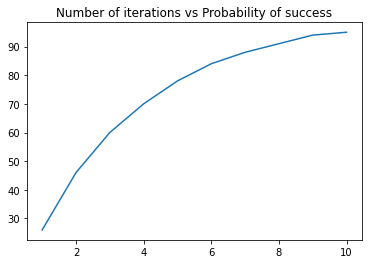

In [302]:
#question 1.3.c
#Using the formula p= 1-(1-(1-e)^s)^N where s=6,e=0.2 and N=1 to 10 
%matplotlib inline
N=[1,2,3,4,5,6,7,8,9,10]
s=6
e=0.2
i=0
p=[]
while i<10:
    p.append(1-(1-(1-e)**s)**N[i])
    i=i+1
p=[round(i * 100) for i in p]
print(p)
plt.figure()
plt.plot(N,p)
plt.title('Number of iterations vs Probability of success')
plt.show()

# Zhang's Method uisng opencv functions
For defining the corresponding 3D world points. we can say that the chessboard was kept stationary at XY plane (so Z=0 always), and camera was moved. This consideration helps us to find only X,Y values.
Now for X,Y values, we can simply pass the points as (0,0), (1,0), (2,0), ... which denotes the location of points.
So we create a meshgrid which will give us all combinations of X-Y coordinates

56


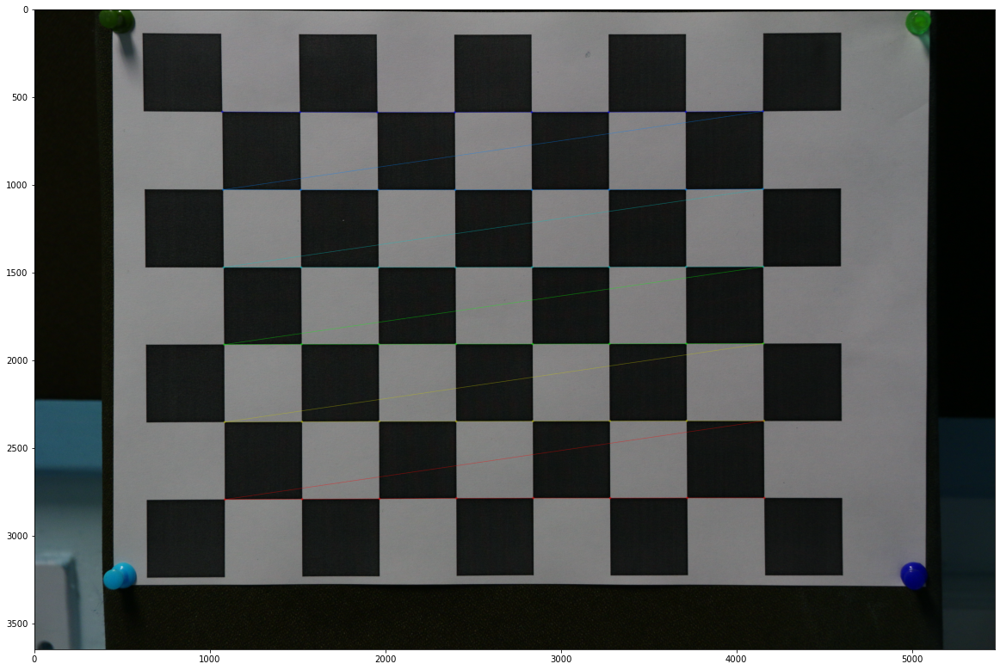

57


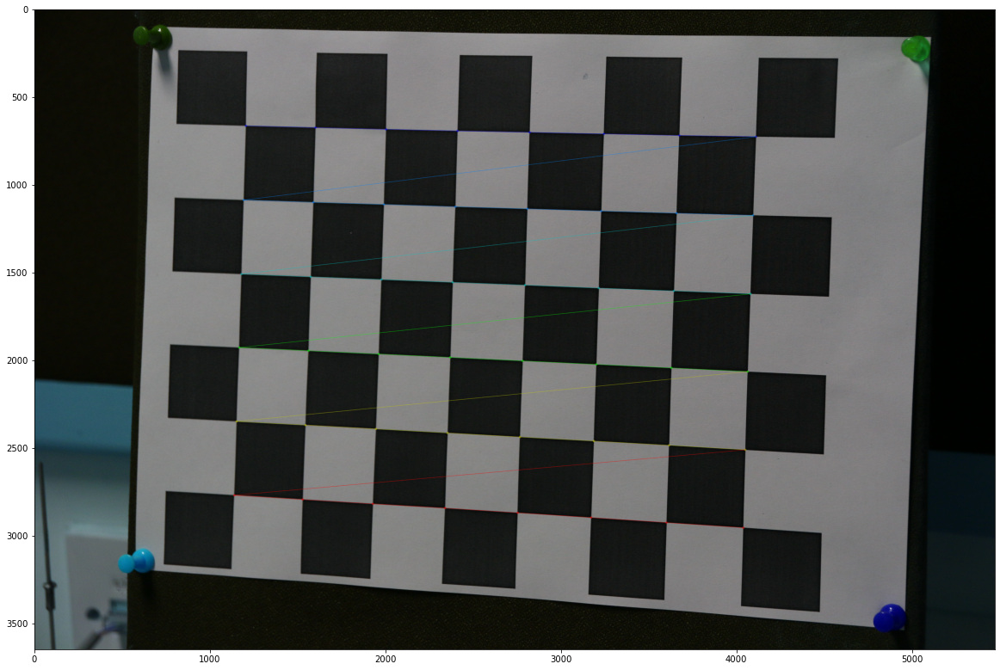

58


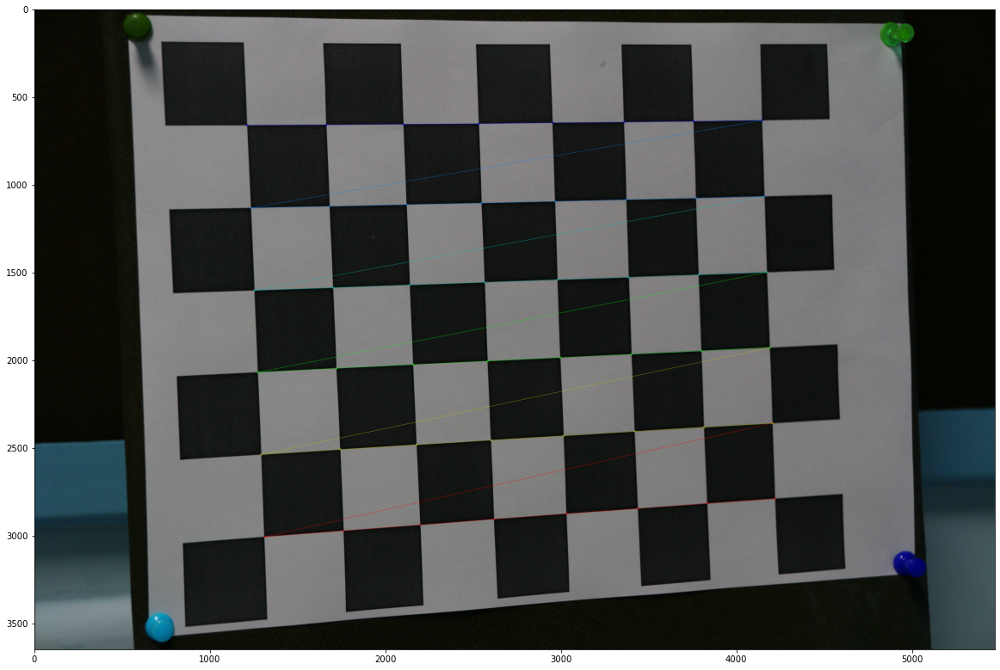

59


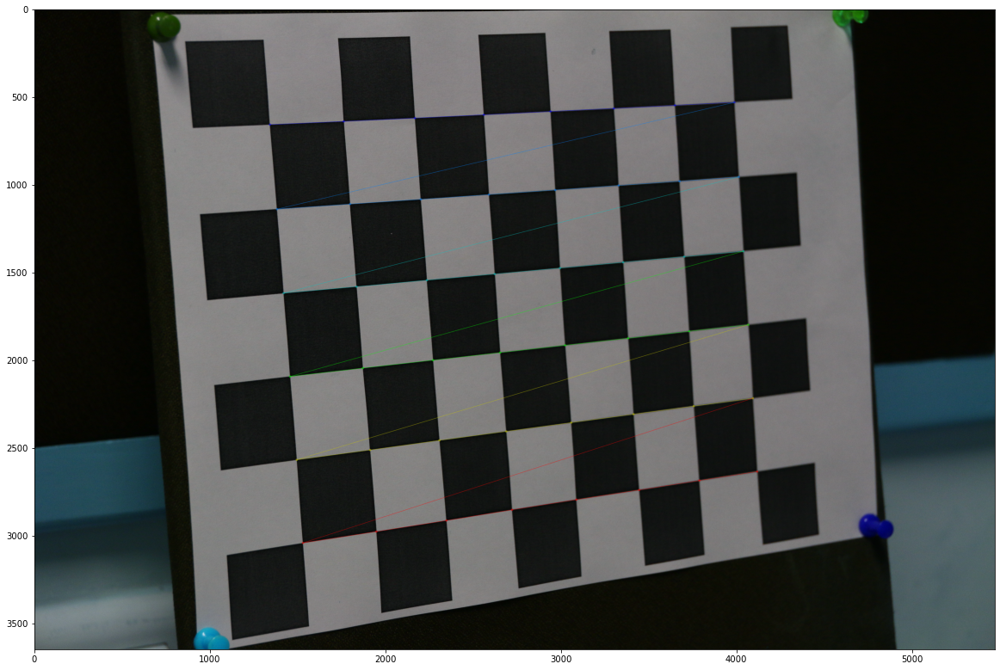

60


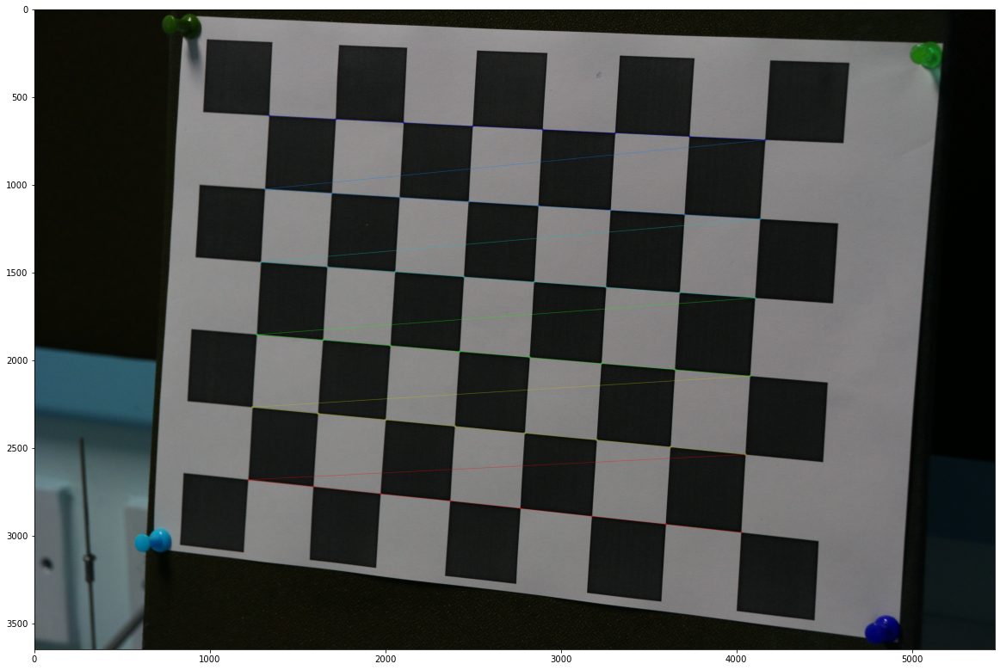

61


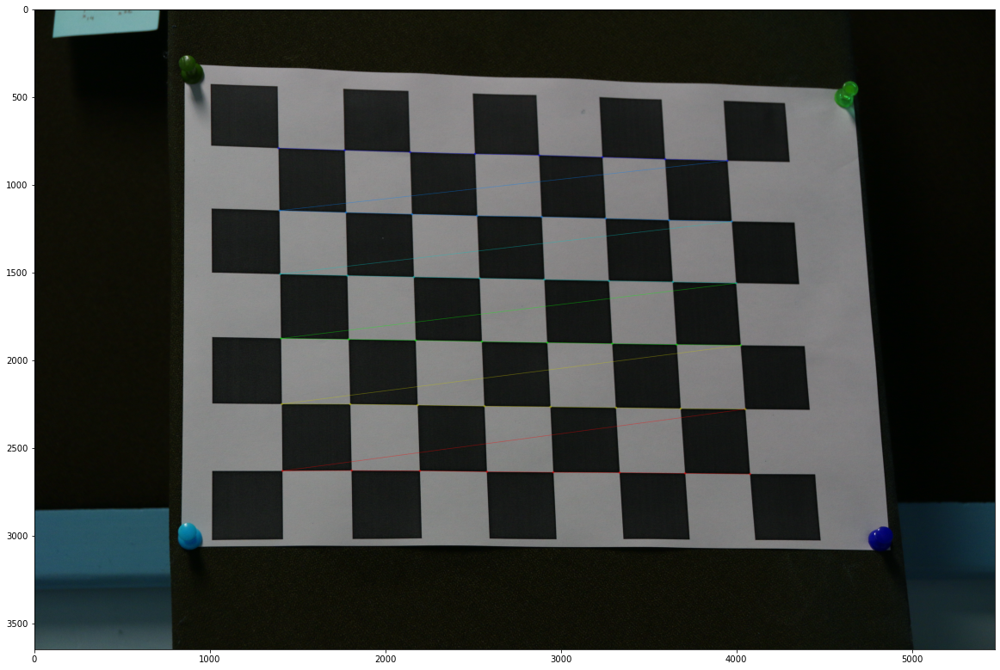

62


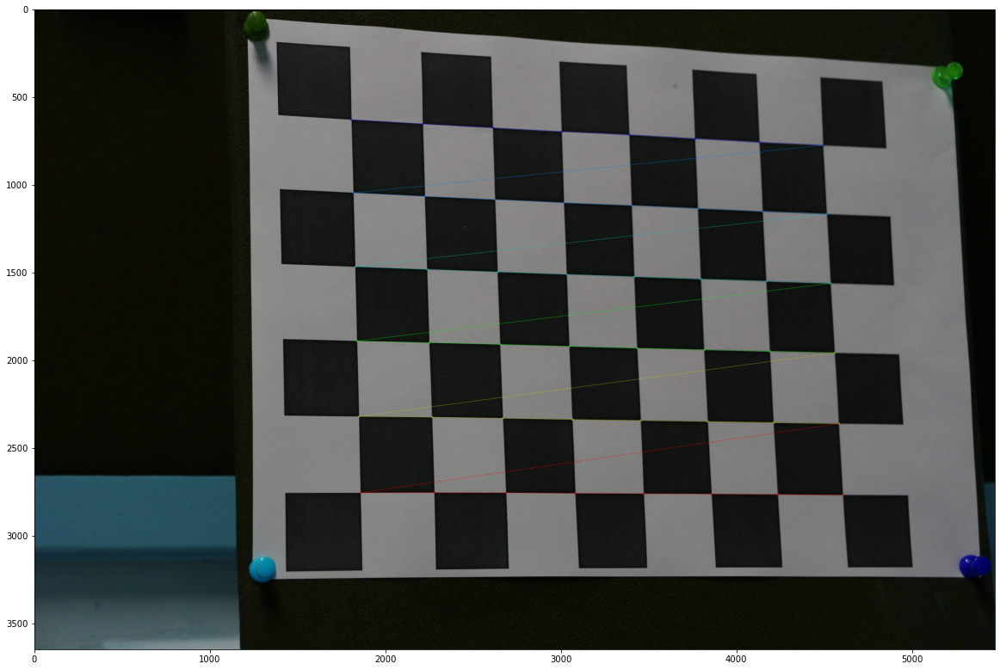

63


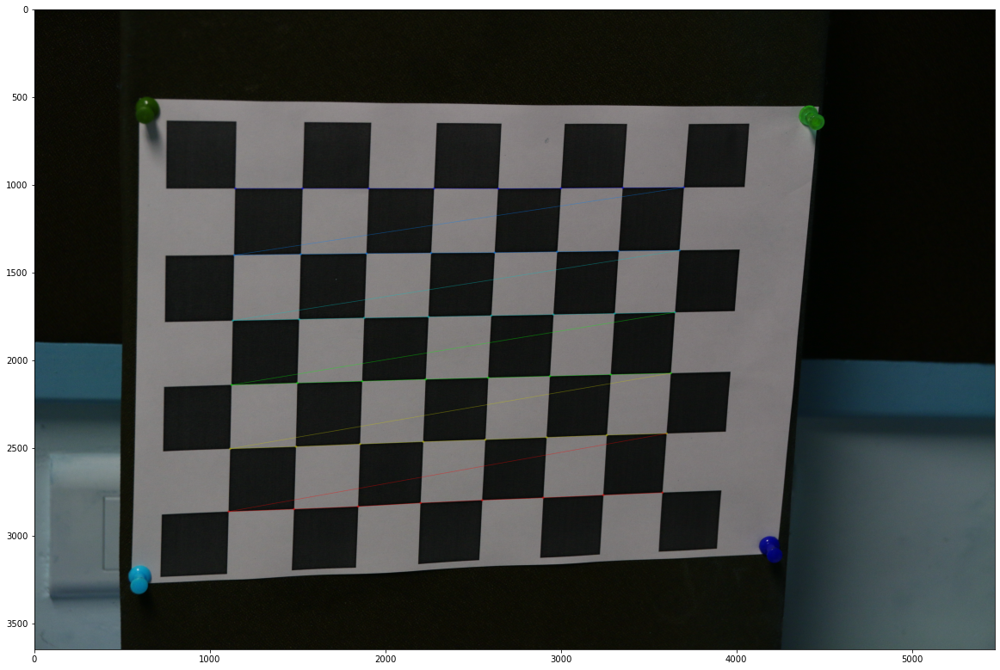

64


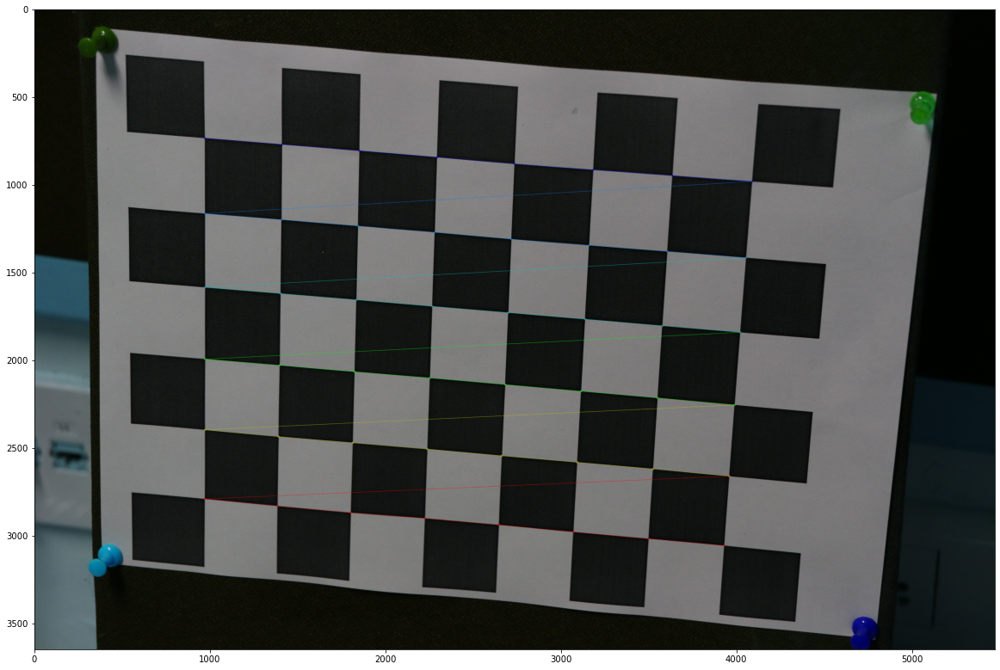

65


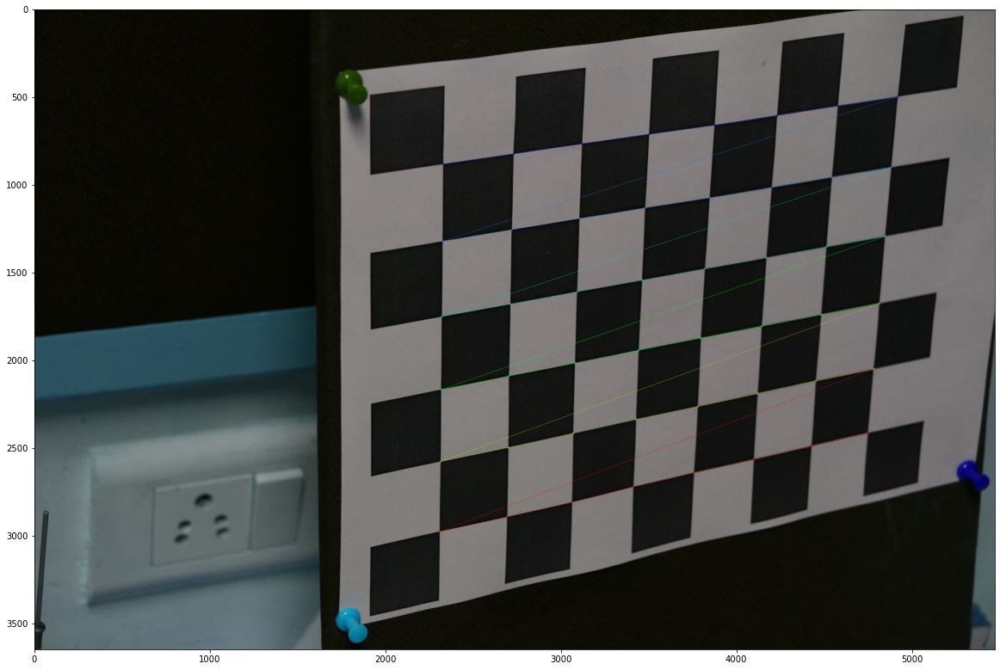

66


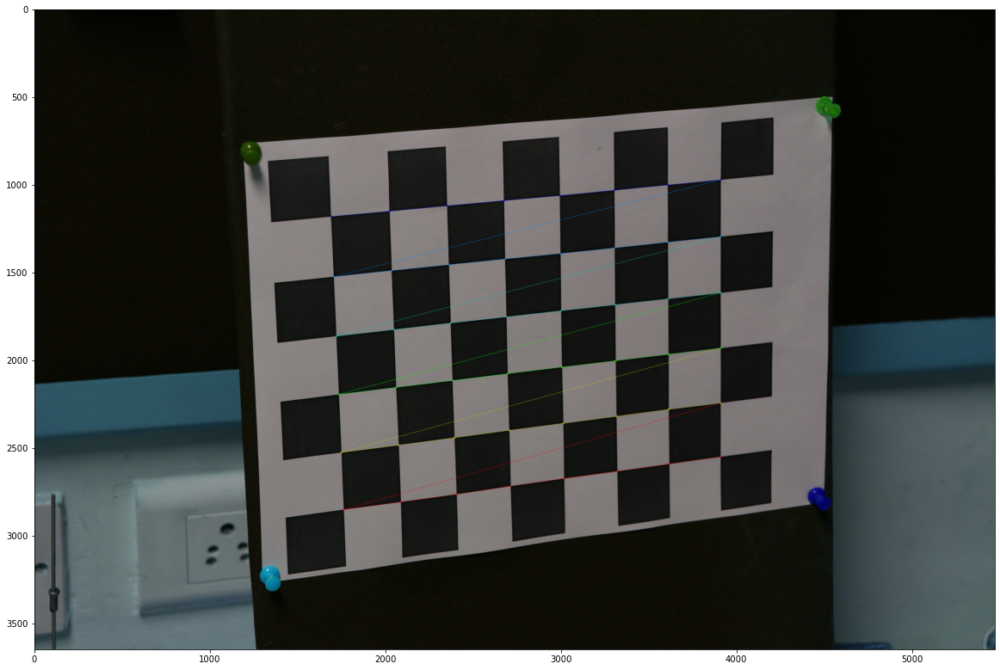

67


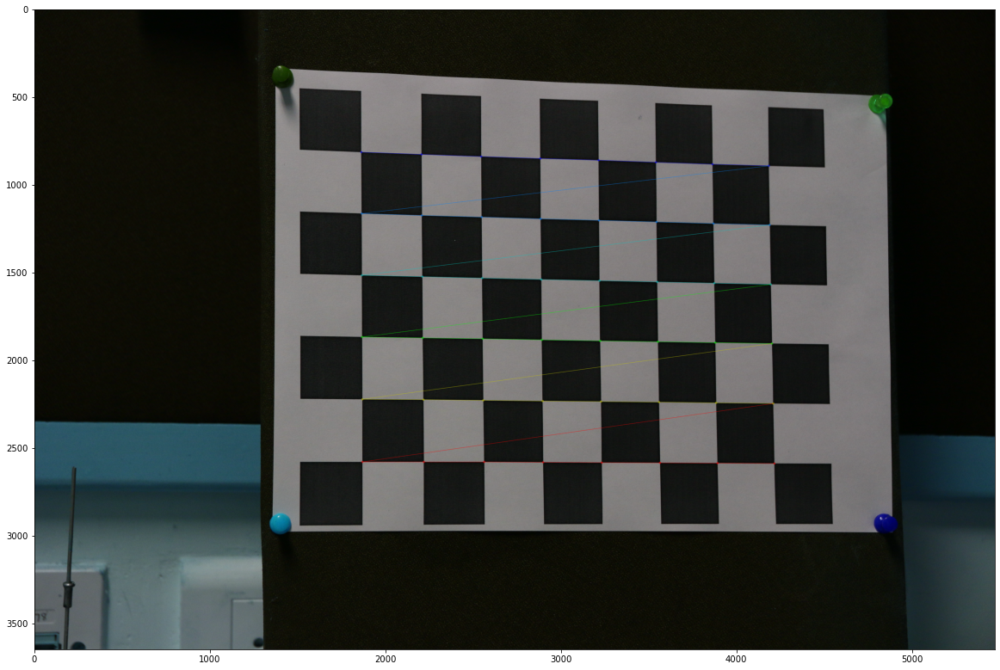

68


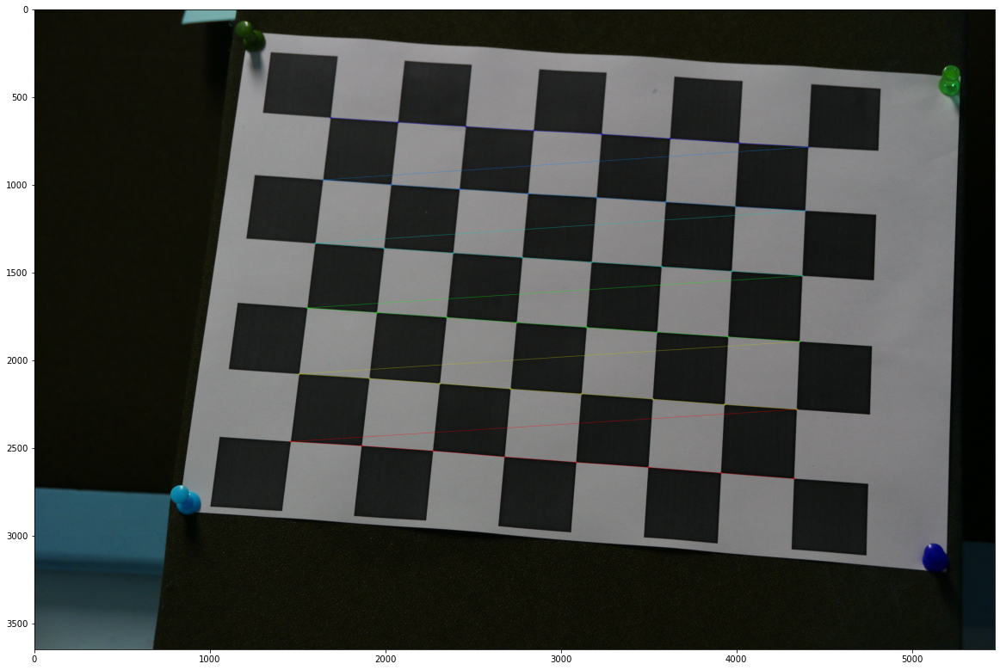

69


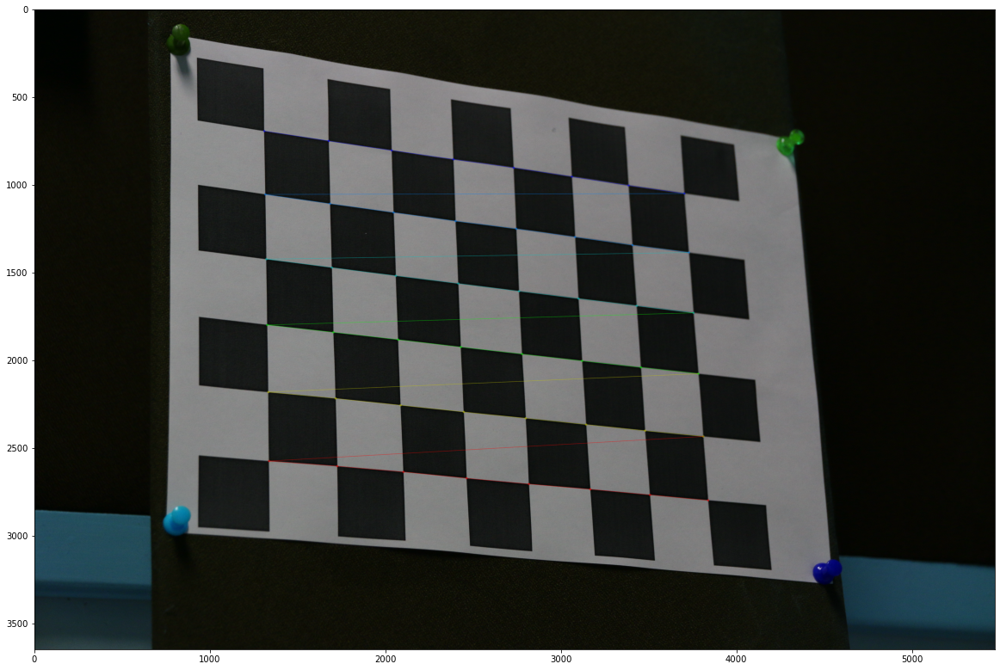

70


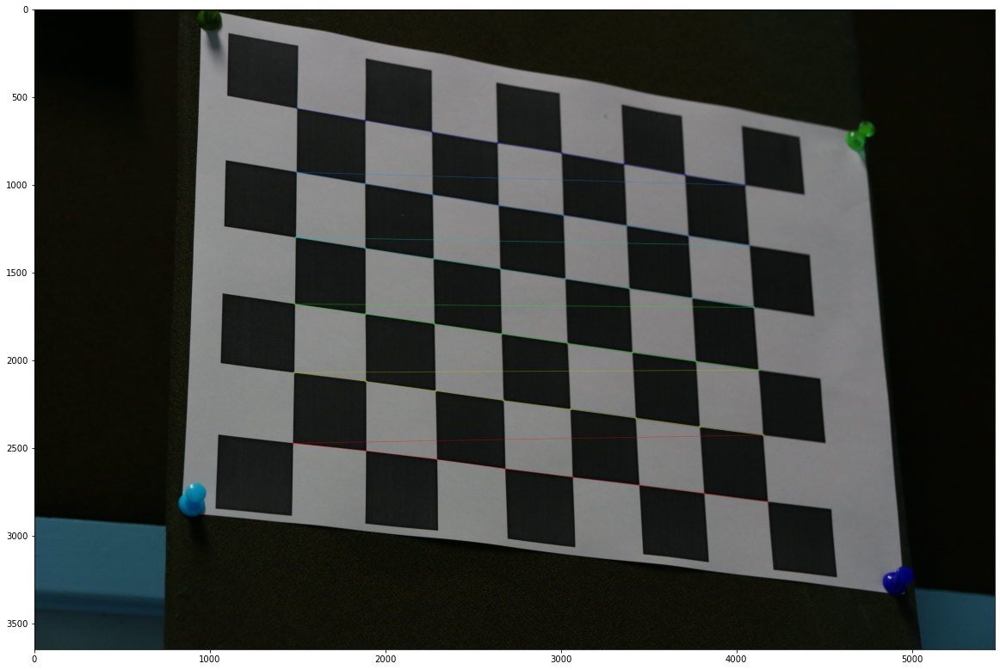

In [303]:
%matplotlib inline
#question 2 Zhang's Method
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
# object points
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.
i=56
while i<71:
    img = cv.imread("C:/Users/91709/Desktop/CV/assignment-1-rez39/calibration-data/IMG_54"+str(i)+".jpg")
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (8,6))
    print(i)
    if ret == True:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners2)
        img1=cv.drawChessboardCorners(img, (8,6),corners2 , ret)
        plt.figure(figsize = [20,20])
        plt.imshow(img1,cmap='gray')
        plt.show()
    i=i+1
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


Camera Calibration Matrix:
[[13641.50954612     0.          3316.35923782]
 [    0.         13663.25175484  1500.37425099]
 [    0.             0.             1.        ]]
External Claibration Matrix
[[ 9.73454404e-01 -3.66063941e-02  2.25934716e-01 -5.02987815e+00]
 [ 3.42723108e-02  9.99310994e-01  1.42458861e-02 -1.97111197e+00]
 [-2.26300536e-01 -6.12441580e-03  9.74038274e-01  3.23262663e+01]]
The Projection matrix is 
 [[ 387.57626901  -16.0760056   195.2700433  1193.77786026]
 [   3.98238732  422.09170317   51.22976657  667.24991452]
 [  -0.00700052   -0.00018946    0.03013148    1.        ]]
[[1193.77786026  667.24991452]
 [1592.50246788  675.96440128]
 [1996.88890271  684.80263239]
 [2407.05862269  693.76726243]
 [2823.13658482  702.86102244]
 [3245.25137205  712.08672272]
 [3673.5353258   721.44725571]
 [4108.12468427  730.94559903]
 [1177.92502001 1089.54803946]
 [1576.61393383 1101.24190355]
 [1980.96525604 1113.1018506 ]
 [2391.10048054 1125.13144412]
 [2807.14460202 1137

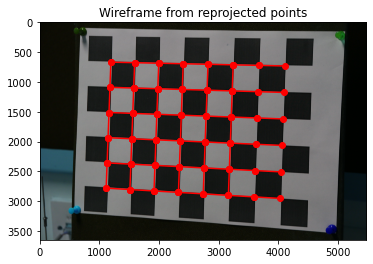

In [304]:
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
print ('\nCamera Calibration Matrix:')
with np.printoptions(suppress=True): print(mtx)
def eulerAnglesToRotationMatrix(theta) :
    R_x = np.array([[1,0,0],[0,math.cos(theta[0]),-math.sin(theta[0])],[0,math.sin(theta[0]), math.cos(theta[0])]])
    R_y = np.array([[math.cos(theta[1]),0,math.sin(theta[1])],[0,1,0],[-math.sin(theta[1]),0,math.cos(theta[1])]])             
    R_z = np.array([[math.cos(theta[2]),-math.sin(theta[2]),0],[math.sin(theta[2]),math.cos(theta[2]),0],[0,0,1]])
    R = np.dot(R_z,np.dot(R_y,R_x))
    return R
imgnum=1
r=  rvecs[imgnum]
R = (eulerAnglesToRotationMatrix(r))
world_points_1 = np.hstack((objp, np.ones((48,1)))).astype(np.float32)
temp1 = np.zeros((3,4))
temp1[0:3,0:3] = R[0:3,0:3]
temp1[:,3] = tvecs[imgnum][:,0]
print('External Claibration Matrix')
print(temp1)
P = np.matmul(mtx,temp1)
P = P/P[2,3]
with np.printoptions(suppress=True): print('The Projection matrix is \n', P)
projected_points = []
for i in range(48):
    projection = np.matmul(P,np.transpose(world_points_1[i,:]))
    projection = projection/projection[2]
    projected_points.append(projection[0:2])

projected_points = np.asarray(projected_points)
projected_points = []
for i in range(48):
    projection = np.matmul(P,np.transpose(world_points_1[i,:]))
    projection = projection/projection[2]
    projected_points.append(projection[0:2])

projected_points = np.asarray(projected_points)
print(projected_points)
img1 = cv.imread("C:/Users/91709/Desktop/CV/assignment-1-rez39/calibration-data/IMG_54"+str(56+imgnum)+".jpg")
def generate_wireframe(idx, idx1, projected_points, img):
    q = 0
    p = 0
    for i in range(projected_points.shape[0]):
        if (i == idx[q]):
            q = q + 1
            continue
        plt.plot([projected_points[i][0],projected_points[i+1][0]],[projected_points[i][1],projected_points[i+1][1]],'ro-')

    for i in range(len(idx)):
        i1 = i
        j =  i + len(idx1)
        while(j < (len(idx)*len(idx1))):
            plt.plot([projected_points[i1][0],projected_points[j][0]],[projected_points[i1][1],projected_points[j][1]],'ro-')
            i1 = j
            j = j + len(idx1)
    plt.imshow(img)
    plt.title('Wireframe from reprojected points')
    plt.show()

idx = [7,15,23,31,39,47]
idx1 = [5,11,17,23,29,35,41,47]

generate_wireframe(idx, idx1, projected_points, img1)

# Question 3 DIY
- The image used is as follows

<IPython.core.display.Javascript object>


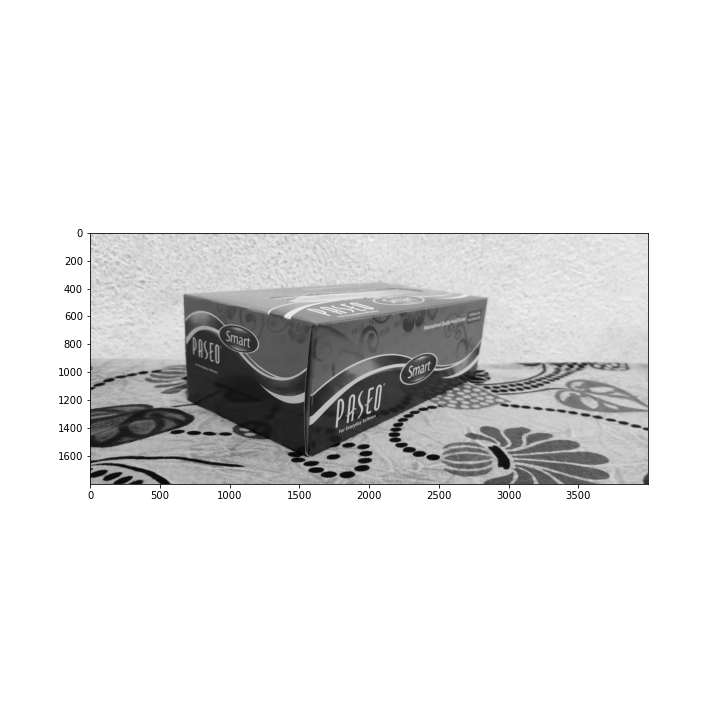

In [307]:
#question 3 DIY
%matplotlib notebook
img=cv.imread("C:/Users/91709/Desktop/CV/assignment-1-rez39/images/DIY3.jpg",0)
plt.figure(figsize=[10,10])
plt.imshow(img,cmap='gray')
plt.show()

# World Points and Image Points Control Points
- (0,0,0) - (1590,663)
- (0,70,0) - (1554,1595)
- (0,0,110) - (665, 440)
- (205,0,0) - (2830, 460)
- (0,70,110) - (694, 1186)
- (205,70,0)- (2751,1028)
- (205,0,110)-(2070,362)
- Two matrices with world coordinates and image coordinates as world and image

In [308]:
world = [(0,0,0),(0,70,0),(0,0,110),(205,0,0),(0,70,110),(205,70,0),(205,0,110)]
image=[(1590,663),(1554,1595),(665, 440),(2830, 460),(694, 1186),(2751,1028),(2070,362)]
P=compute_DLT(world,image)
P=P/P[2,3]
print('Projection Matrix',P)
point = np.array([0,70,0,1])
xy = np.dot(P, point)
xy = xy/xy[2]
with np.printoptions(suppress=True): print('Estimated Image points',xy[0:2])
print('Original Image Points',image[1])


Projection Matrix [[ 1.66680208e+01  1.40986055e+00 -6.55838887e+00  1.58925668e+03]
 [ 8.19891471e-01  1.54040384e+01 -7.36885438e-01  6.56385014e+02]
 [ 3.74698003e-03  1.24841232e-03  2.75579252e-03  1.00000000e+00]]
Estimated Image points [1552.29373832 1595.25976654]
Original Image Points (1554, 1595)


The points match pretty well

In [309]:
# Projection error
ones = np.ones((7,1))
image = np.array(image)
image_new = np.hstack((image, ones))

world = np.array(world)
world_new = np.hstack((world, ones))
c=0
error=[]
for i in range(0,7):
    expected = np.dot(P, world_new[i])
    expected = expected/expected[2]
    actual = image_new[i]
    error.append(np.linalg.norm(actual-expected))
    if(error[i]<5):
        c += 1;
print('error using DLT for DIY image',np.mean(error))


error using DLT for DIY image 3.6973380622915397


Now lets try Ransac for the same

In [310]:
best1, best_itr = RANSAC(world, image,10)
best1=best1/best1[2,3]
print("\n The best projection matrix we get is: \n")
with np.printoptions(suppress=True): print(best1)
print("\n and this corresponds to iteration number ", best_itr)


[6, 4, 3, 5, 5, 2]
0 . Number of Points correctly projected:  5
[6, 3, 4, 4, 3, 5]
1 . Number of Points correctly projected:  4
[3, 2, 0, 5, 6, 6]
2 . Number of Points correctly projected:  5
[6, 3, 1, 0, 6, 4]
3 . Number of Points correctly projected:  5
[6, 1, 3, 0, 0, 4]
4 . Number of Points correctly projected:  5
[5, 3, 5, 4, 2, 2]
5 . Number of Points correctly projected:  4
[3, 3, 2, 2, 4, 5]
6 . Number of Points correctly projected:  4
[2, 1, 4, 6, 1, 0]
7 . Number of Points correctly projected:  5
[0, 4, 1, 4, 0, 1]
8 . Number of Points correctly projected:  0
[5, 1, 4, 0, 3, 0]
9 . Number of Points correctly projected:  5

 The best projection matrix we get is: 

[[  10.25087877    1.06364794   -9.17613466 1675.99995505]
 [   0.20975652   11.79117383   -1.18112609  570.99915175]
 [   0.00163308    0.00093422    0.00002222    1.        ]]

 and this corresponds to iteration number  0


<ipython-input-296-8fea12c7e147>:33: RuntimeWarning: invalid value encountered in true_divide
  expected = expected/expected[2]
<ipython-input-296-8fea12c7e147>:33: RuntimeWarning: divide by zero encountered in true_divide
  expected = expected/expected[2]


In [311]:
error=[]
for i in range(0,7):
    expected = np.dot(best1, world_new[i])
    expected = expected/expected[2]
    actual = image_new[i]
    error.append(np.linalg.norm(actual-expected))
    if(error[i]<5):
        c += 1;
print('error using RANSAC for DIY image',np.mean(error))

error using RANSAC for DIY image 60.55348165468019
